### Load molecules from Electrostatic Discovery and Structure discovery in Atomic Force Microscopy imaging of ice

In [1]:
# IMPORTS
# additional packages
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
import argparse
import os
import time
from scipy import ndimage

import glob
from tqdm import tqdm
import scipy
import seaborn as sns
import rdkit.Chem.AllChem as AllChem
import sys
USER = os.getenv('USER')
sys.path.append(f'/home/{USER}/CODE/Pytorch-fingerprints/')
# torch packages
import torch
import torchvision
import torch.nn as nn
import torch.backends.cudnn as cudnn
import torch.utils.data as data
from torch import optim
from torchvision import datasets, transforms, models
from torchvision.models import resnet50, ResNet50_Weights, efficientnet_b0, EfficientNet_B0_Weights
import torchvision.transforms.functional as TF

from torchmetrics import MetricCollection
from torchmetrics.classification import MultilabelRecall, MultilabelPrecision, MultilabelF1Score

import torch.nn.functional as F
from torch.utils.data import Dataset

print('PyTorch version:', torch.__version__)

# custom functions
from utils.all_utils import train_test_split, compute_pos_weights, save_config, train_for_epoch, validate, \
                            balance_beta_pos_weights, tanimoto_torch, validate_tanimoto

from utils.models import ResNet3D, resnet_10_chan, effnet_10_chan, eff_net_bias_warmer, resnet_bias_warmer 

from utils.dataloader import QUAM

from utils.screening import fp_screening_function, load_img_stack, predict_fp, tanimoto_numpy





print('Packages loaded')


class configuration:
    def __init__(self):
        # EXPERIMENT PARAMETERS
        self.experiment_name = 'exp_imgs'
        self.n_fp = 1024  # number of fingerprints
        self.output_size = 9
        self.ratio = 0.95  # train/test ratio
        self.seed = 42

        # TRAINING PARAMETERS

        self.lr = 0.001  # learning rate
        self.dropout = 0.5 # Dropout2d probability
        # self.momentum = 0.9  # momentum of SGD optimizer
        self.weight_decay = 0  # L2 regularization constant
        self.batch_size = 50  # Training batch size
        self.test_batch_size = 50  # Test batch size
        self.epochs = 150  # Number of epochs
        self.bias_warmer = True # setting appropiate bias
        self.pos_weight_balancer = True #for bigger fingerprints, it helps balance precision and recall
        self.pos_weight_beta = 10
        # DATA AUGMENTATION PARAMETERS

        # Rotation
        self.rot_prob = 0.5  # prob of rotation in data augmentation
        self.max_deg = 180  # maximum degrees of rotation in data augmentation

        # Zoom
        self.zoom_prob = 0.3  # prob of applying zoom
        self.max_zoom = 0.3  # maximum zooming in/out

        # Translation
        self.shift_prob = 0.3  # probability of vertical or/and horizontal translation
        self.max_shift = 20  # translation

        # Shear
        self.shear_prob = 0.3  # probability of shearing
        self.max_shear = 10  # maximum shearing angle

## Create arguments object
args = configuration()
# Print experiment name
print('Experiment name:', args.experiment_name)


# make sure to enable GPU acceleration!
print(f'available devices: {torch.cuda.device_count()}')
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
#torch.cuda.device(0)
#device = torch.device('cpu')
#print(device, torch.cuda.get_device_name(0))

# Set random seed for reproducibility
torch.backends.cudnn.deterministic = True  # fix the GPU to deterministic mode
torch.manual_seed(args.seed)  # CPU seed
torch.cuda.manual_seed_all(args.seed)  # GPU seed
random.seed(args.seed)  # python seed for image transformation
np.random.seed(args.seed)



PyTorch version: 1.12.1
Packages loaded
Experiment name: exp_imgs
available devices: 0


# Electrostatic Discovery

### BCB: 1-Bromo-3,5-dichlorobenzene
https://pubchem.ncbi.nlm.nih.gov/compound/29766

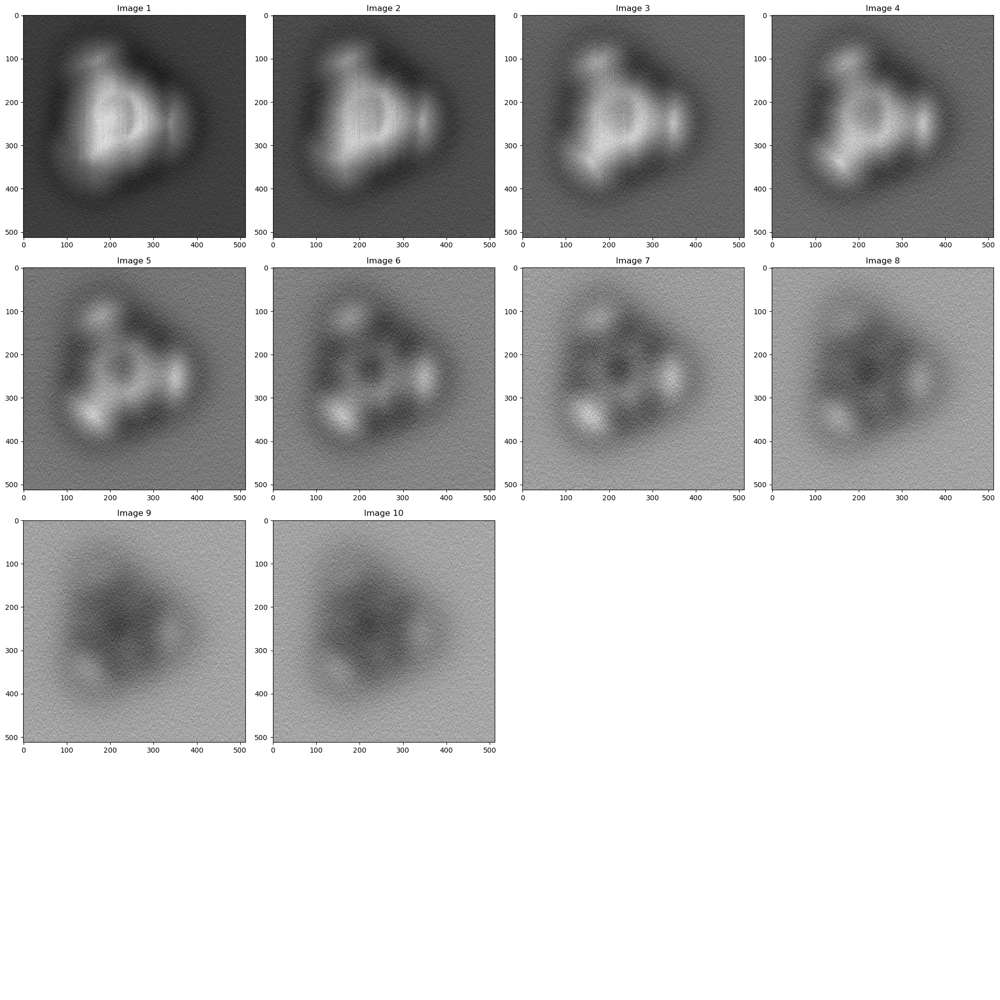

In [8]:
path = f'/home/{USER}/CODE/ED-AFM/data/BCB/data_CO_exp.npz'
bcb_molec = np.load(path)

arr = bcb_molec['data']
arr = arr[:, :, ::-1][:,:,:-3]
# decide the number of rows and columns
nrows, ncols = 4, 4

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < arr.shape[2]:
        # display image in grayscale
        img = ax.imshow(arr[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

In [14]:
def process_AFM_images_pil(image_array, operator='laplacian'):
    '''Processes AFM images by applying an operator to highlight bonds and charges.

    INPUT: 
    - image_array: numpy array representation of the AFM image
    - operator: operator to be applied, one of 'laplacian', 'sobel', 'prewitt', 'canny'

    OUTPUT: 
    - numpy array of the processed image
    '''

    # Convert numpy array to grayscale PIL image
    image_pil = Image.fromarray(np.uint8(image_array)).convert('L')
    img = np.array(image_pil)

    if operator == 'laplacian':
        # Apply Laplacian filter
        laplacian_kernel = np.array([[0, -1, 0], [-1, 4, -1], [0, -1, 0]])
        result = ndimage.convolve(img, laplacian_kernel)

    elif operator == 'sobel':
        # Apply Sobel filter
        sobel_kernel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
        sobel_kernel_y = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])
        sobel_x = ndimage.convolve(img, sobel_kernel_x)
        sobel_y = ndimage.convolve(img, sobel_kernel_y)
        result = np.hypot(sobel_x, sobel_y)

    elif operator == 'prewitt':
        # Apply Prewitt filter
        prewitt_kernel_x = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
        prewitt_kernel_y = np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]])
        prewitt_x = ndimage.convolve(img, prewitt_kernel_x)
        prewitt_y = ndimage.convolve(img, prewitt_kernel_y)
        result = np.hypot(prewitt_x, prewitt_y)

    elif operator == 'canny':
        # Apply Canny filter
        result = cv2.Canny(img, 100, 200)

    else:
        raise ValueError(f"Unknown operator {operator}, please choose one of 'laplacian', 'sobel', 'prewitt', 'canny'")

    # Shift the result to an unsigned 8-bit range before returning
    result_shifted = result - result.min()
    result_shifted = (result_shifted / result_shifted.max() * 255).astype(np.uint8)

    return result_shifted


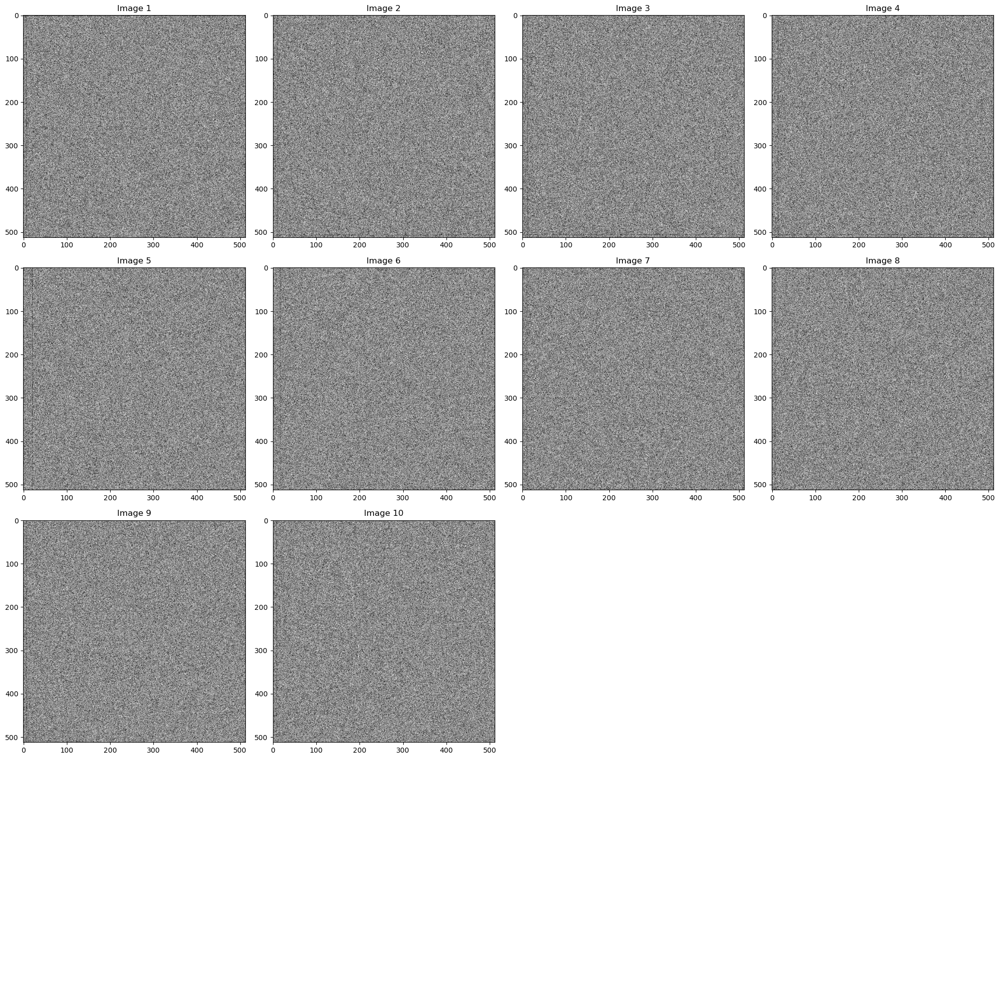

In [20]:
arr = bcb_molec['data']
arr = arr[:, :, ::-1][:,:,:-3]
# decide the number of rows and columns
nrows, ncols = 4, 4

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < arr.shape[2]:
        # display image in grayscale
        post_laplace=process_AFM_images_pil(arr[:, :, i], operator='prewitt')
        img = ax.imshow(post_laplace, cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

In [18]:
def save_images(arr, path):
    # Check if the specified path exists, if not create it.
    if not os.path.exists(path):
        os.makedirs(path)

    # iterate over all images
    for i in range(arr.shape[2]):
        # create file name
        filename = os.path.join(path, f'image_{i}.jpg')

        # save the image
        plt.imsave(filename, arr[:, :, i], cmap='gray')
        
path = f'/home/{USER}/EXPERIMENTAL_IMAGES/RAW/1-Bromo-3,5-dichlorobenzene' 
save_images(bcb_molec['data'][:, :, ::-1][:,:,:-3], path)

In [8]:
bcb_molec['data'][:, :, 3:].shape

(512, 512, 10)

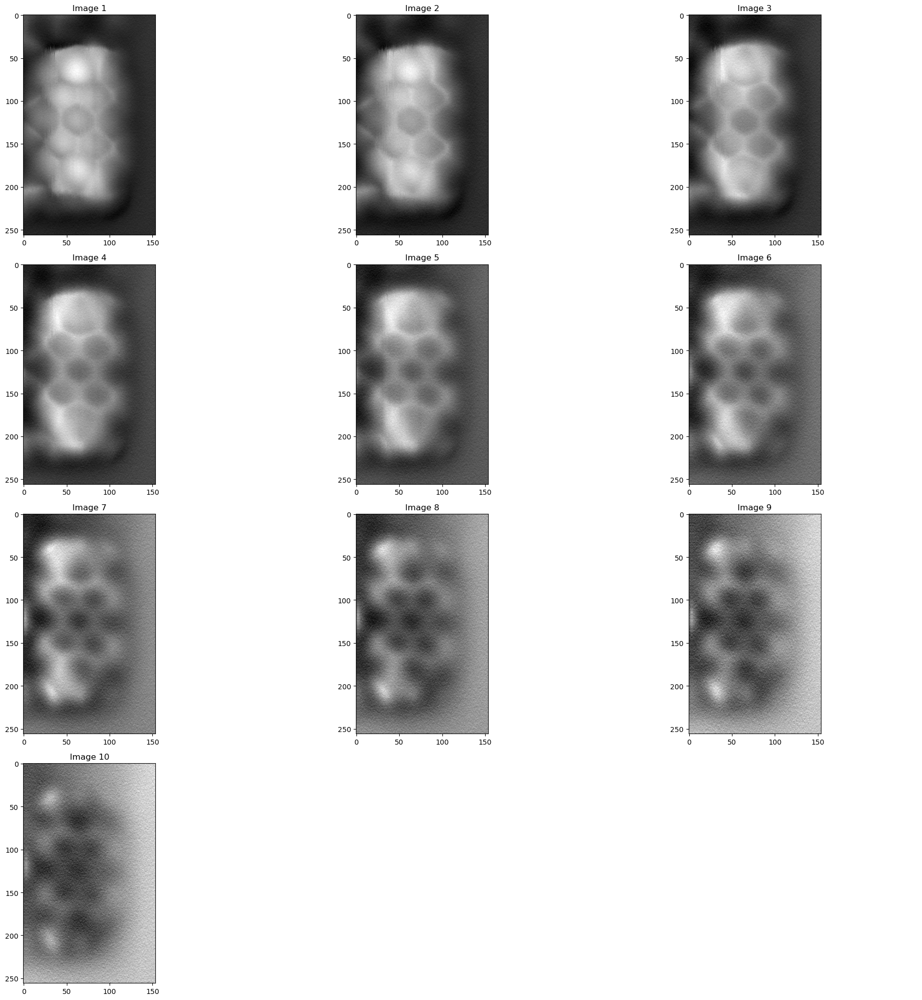

In [2]:
path = f'/home/{USER}/CODE/ED-AFM/data/PTCDA/data_CO_exp.npz'
PTCDA_molec = np.load(path)

arr = PTCDA_molec['data']
arr = arr[:, :, ::-1][:,:,:-6]
# decide the number of rows and columns
nrows, ncols = 4, int(np.ceil(arr.shape[2]/4))

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < arr.shape[2]:
        # display image in grayscale
        img = ax.imshow(arr[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

In [3]:
def save_images(arr, path):
    # Check if the specified path exists, if not create it.
    if not os.path.exists(path):
        os.makedirs(path)

    # iterate over all images
    for i in range(arr.shape[2]):
        # create file name
        filename = os.path.join(path, f'image_{i}.jpg')

        # save the image
        plt.imsave(filename, arr[:, :, i], cmap='gray')
        
path = f'/home/{USER}/EXPERIMENTAL_IMAGES/RAW/Perylenetetracarboxylic_dianhydride_PTCDA' 
save_images(PTCDA_molec['data'][:, :, ::-1][:,:,:-6], path)

In [15]:
path = f'/home/{USER}/CODE/ED-AFM/data/PTCDA/data_CO_exp.npz'
PTCDA_molec = np.load(path)

arr = PTCDA_molec['data']

# decide the number of rows and columns
nrows, ncols = 4, int(np.ceil(arr.shape[2]/4))

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < arr.shape[2]:
        # display image in grayscale
        img = ax.imshow(arr[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

{'_files': ['data.npy', 'lengthX.npy', 'lengthY.npy'],
 'files': ['data', 'lengthX', 'lengthY'],
 'allow_pickle': False,
 'max_header_size': 10000,
 'pickle_kwargs': {'encoding': 'ASCII', 'fix_imports': True},
 'zip': <zipfile.ZipFile file=<_io.BufferedReader name='/home/mgonzalez/CODE/ED-AFM/data/NCM/data_CO.npz'> mode='r'>,
 'f': <numpy.lib.npyio.BagObj at 0x7fe1bef1f280>,
 'fid': <_io.BufferedReader name='/home/mgonzalez/CODE/ED-AFM/data/NCM/data_CO.npz'>}

# Structure discovery in Atomic Force Microscopy imaging of ice

In [3]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Chen_CO/data.npy'
exp_molecule = np.load(path)


In [7]:
exp_molecule.shape

(512, 512, 21)

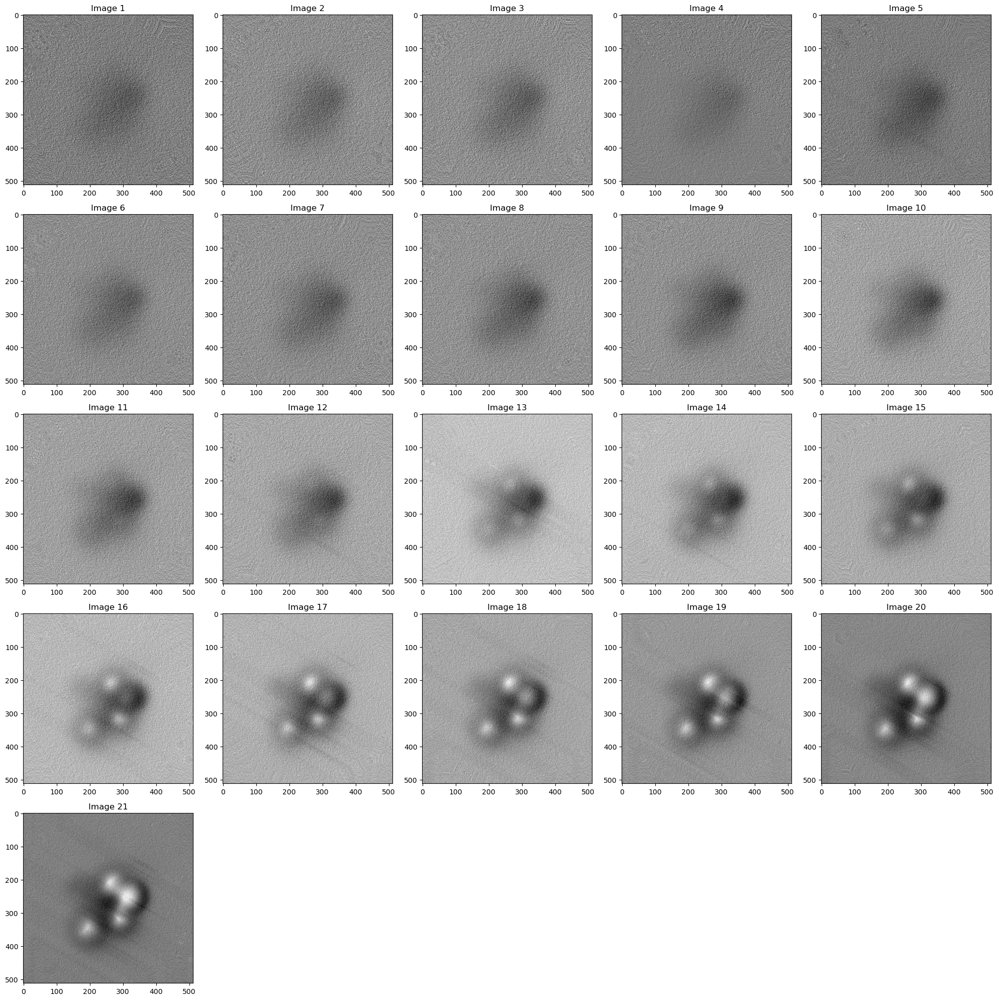

In [8]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Chen_CO/data.npy'
exp_molecule = np.load(path)

nrows, ncols = 5, 5

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

(256, 256, 12)


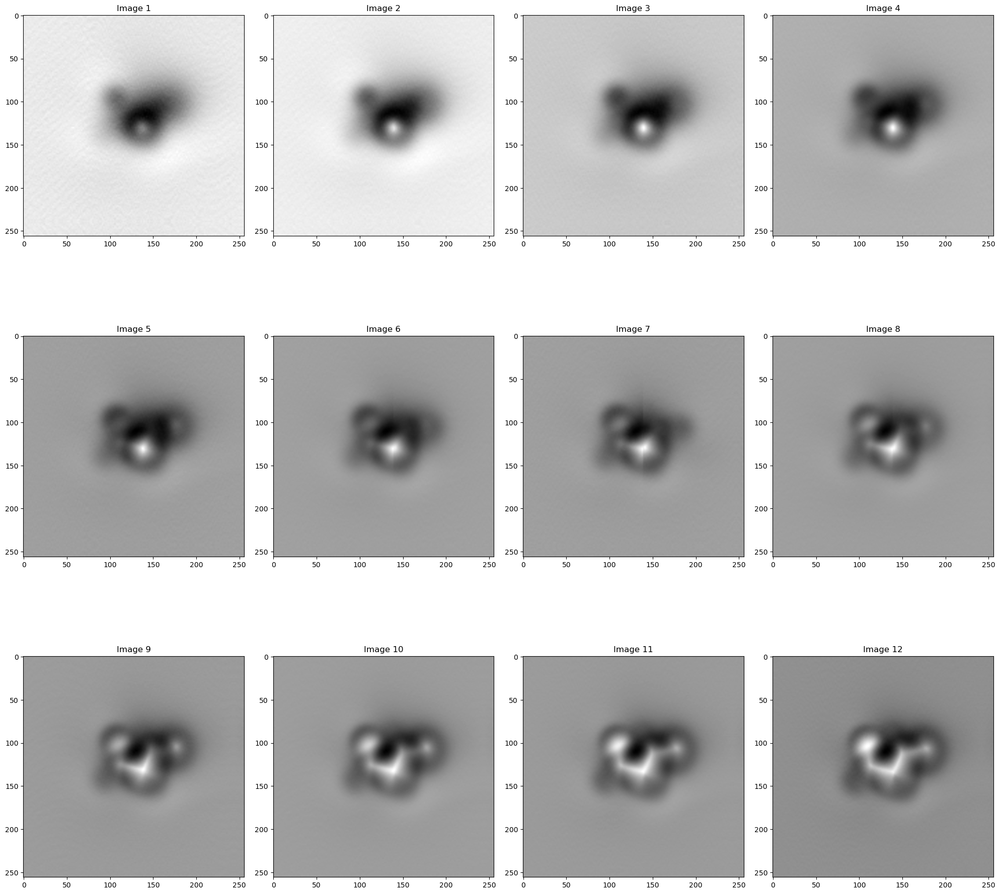

In [13]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Ying_Jiang_1/data.npy'
exp_molecule = np.load(path)
print(exp_molecule.shape)
nrows, ncols = 3, 4

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

(272, 272, 9)


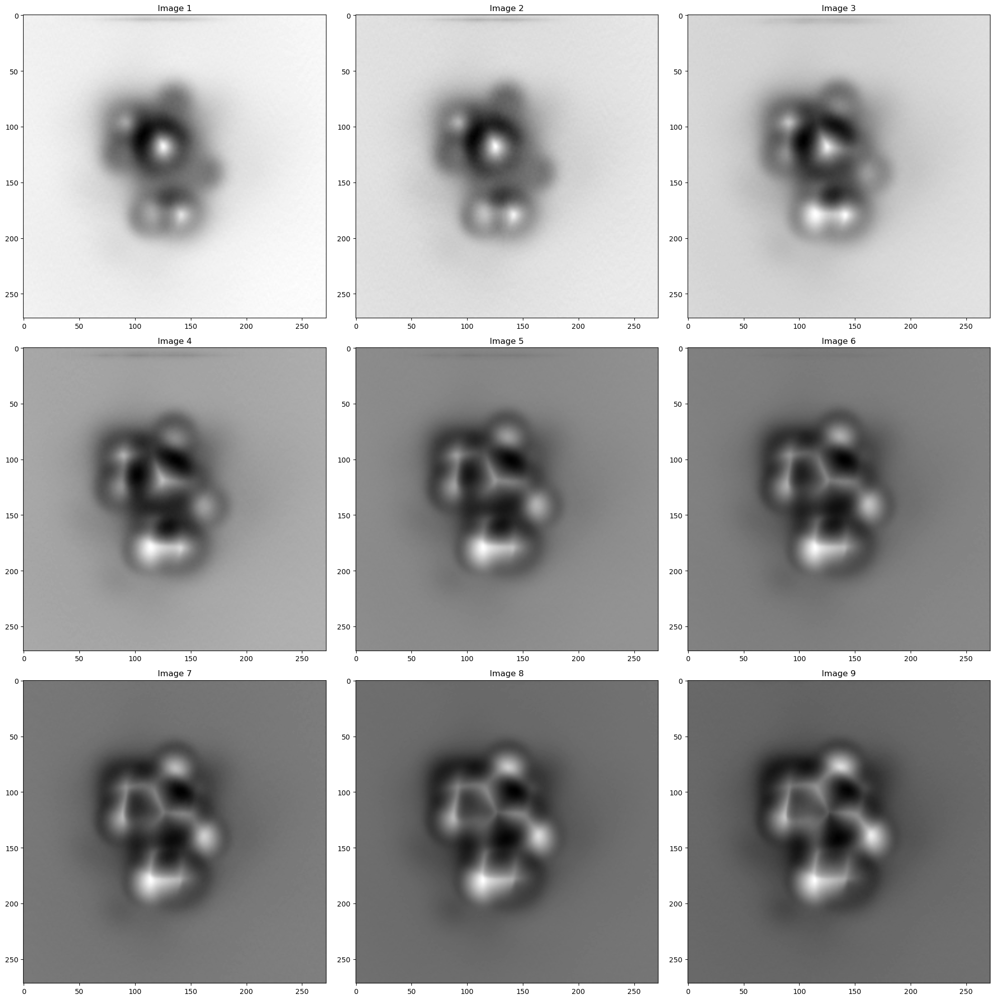

In [14]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Ying_Jiang_2_1/data.npy'
exp_molecule = np.load(path)
print(exp_molecule.shape)
nrows, ncols = 3, 3

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

(272, 272, 9)


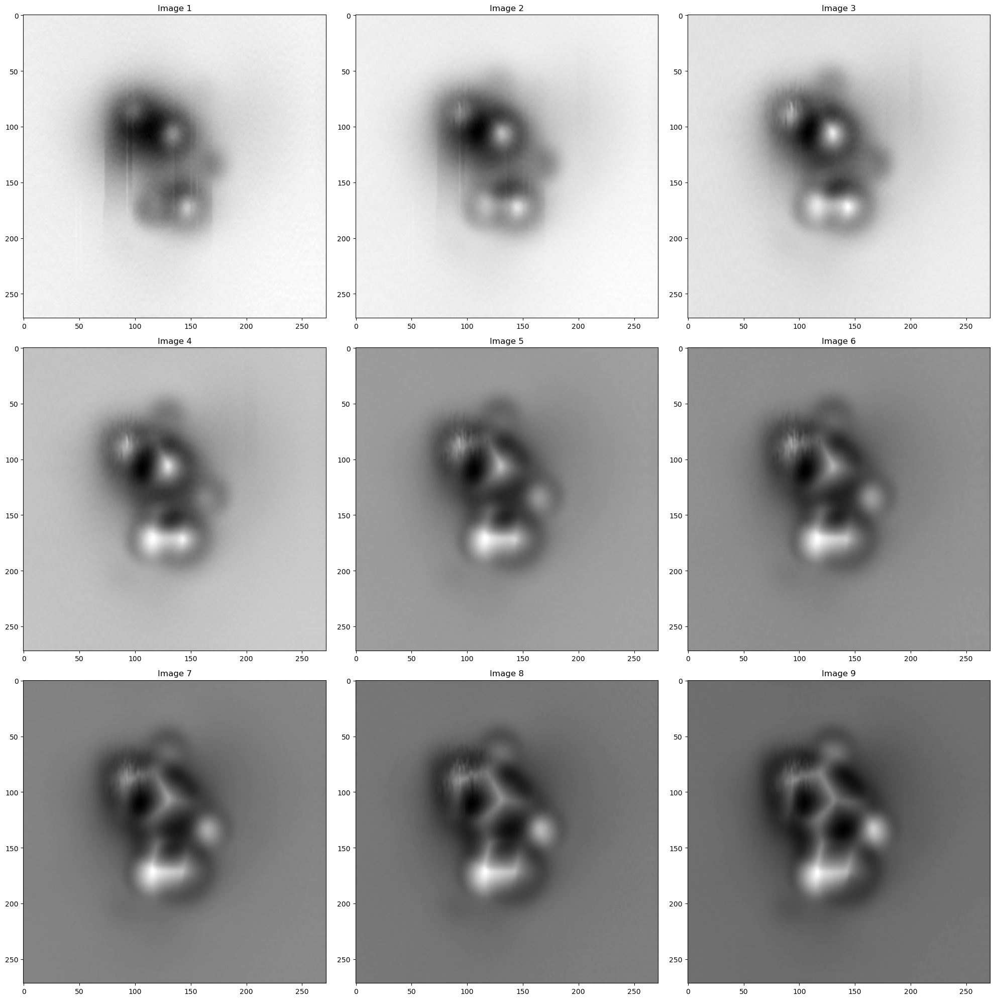

In [15]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Ying_Jiang_2_2/data.npy'
exp_molecule = np.load(path)
print(exp_molecule.shape)
nrows, ncols = 3, 3

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

(320, 320, 9)


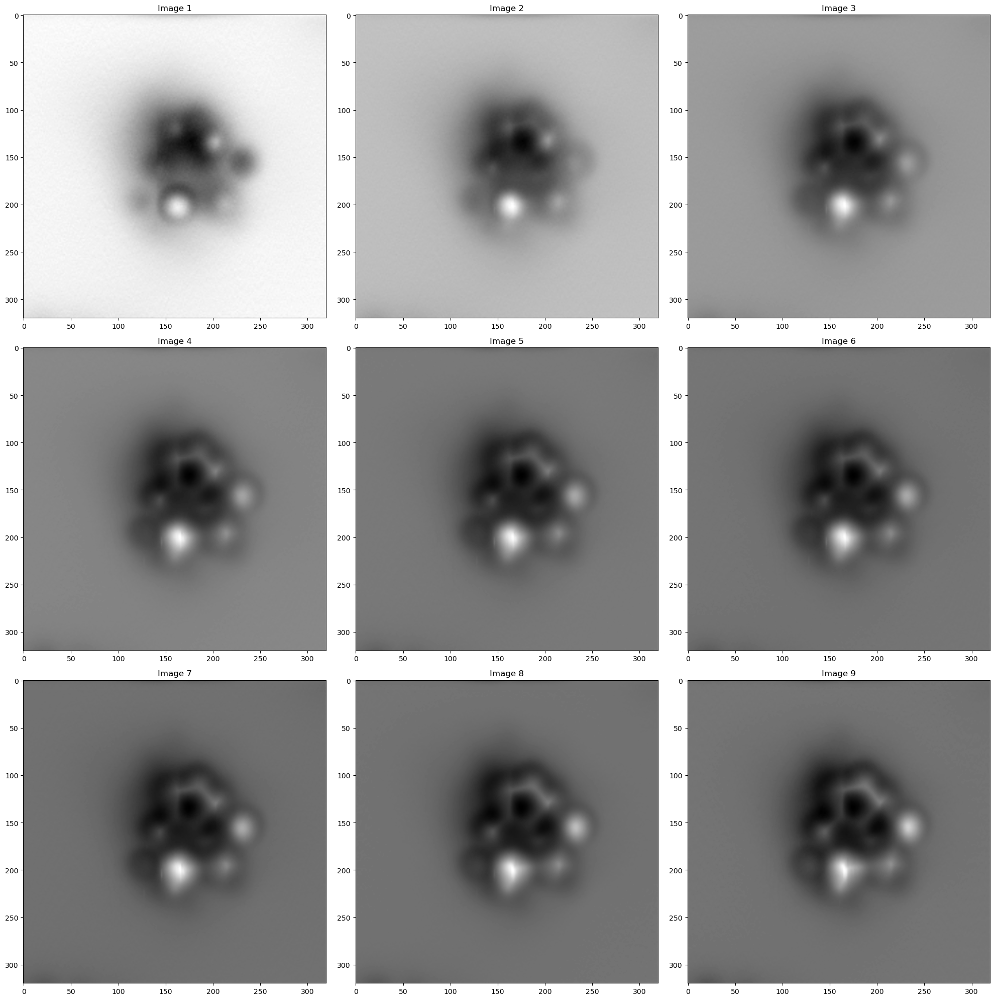

In [16]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Ying_Jiang_3/data.npy'
exp_molecule = np.load(path)
print(exp_molecule.shape)
nrows, ncols = 3, 3

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

(480, 480, 7)


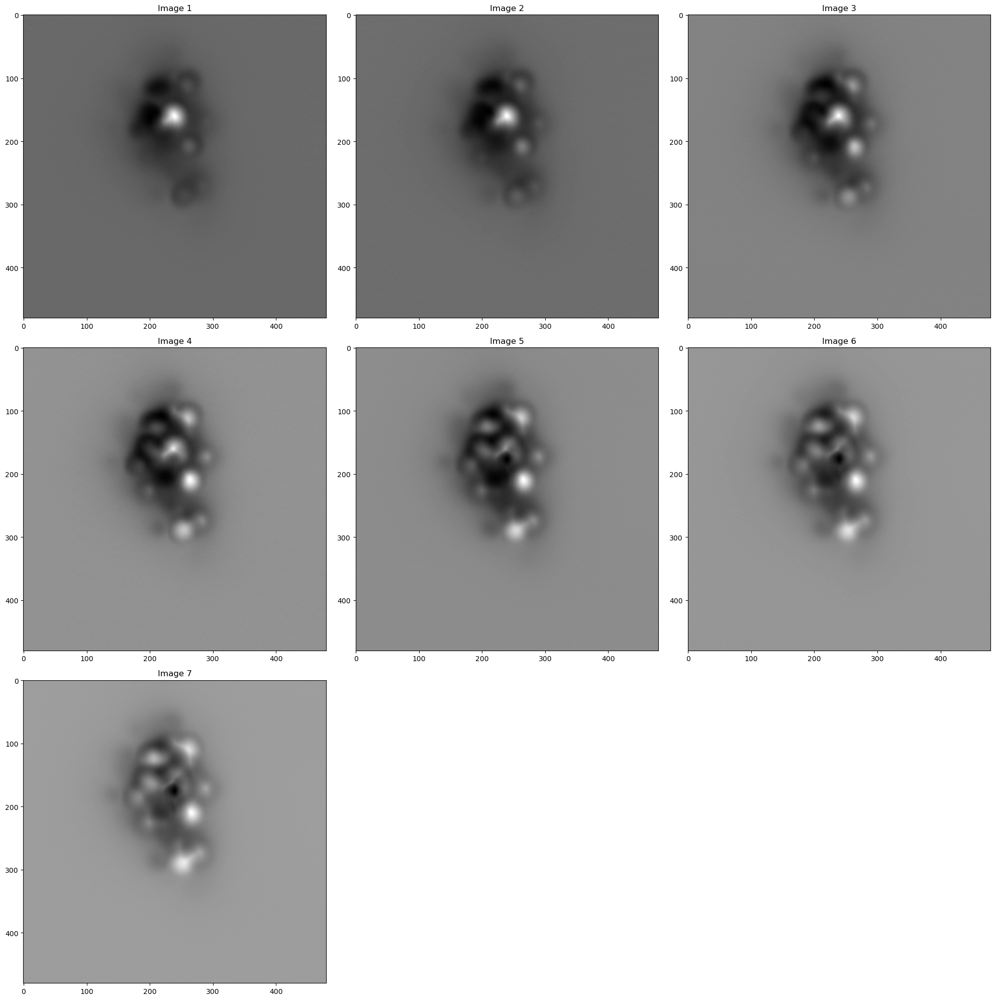

In [17]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Ying_Jiang_4/data.npy'
exp_molecule = np.load(path)
print(exp_molecule.shape)
nrows, ncols = 3, 3

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

(320, 320, 11)


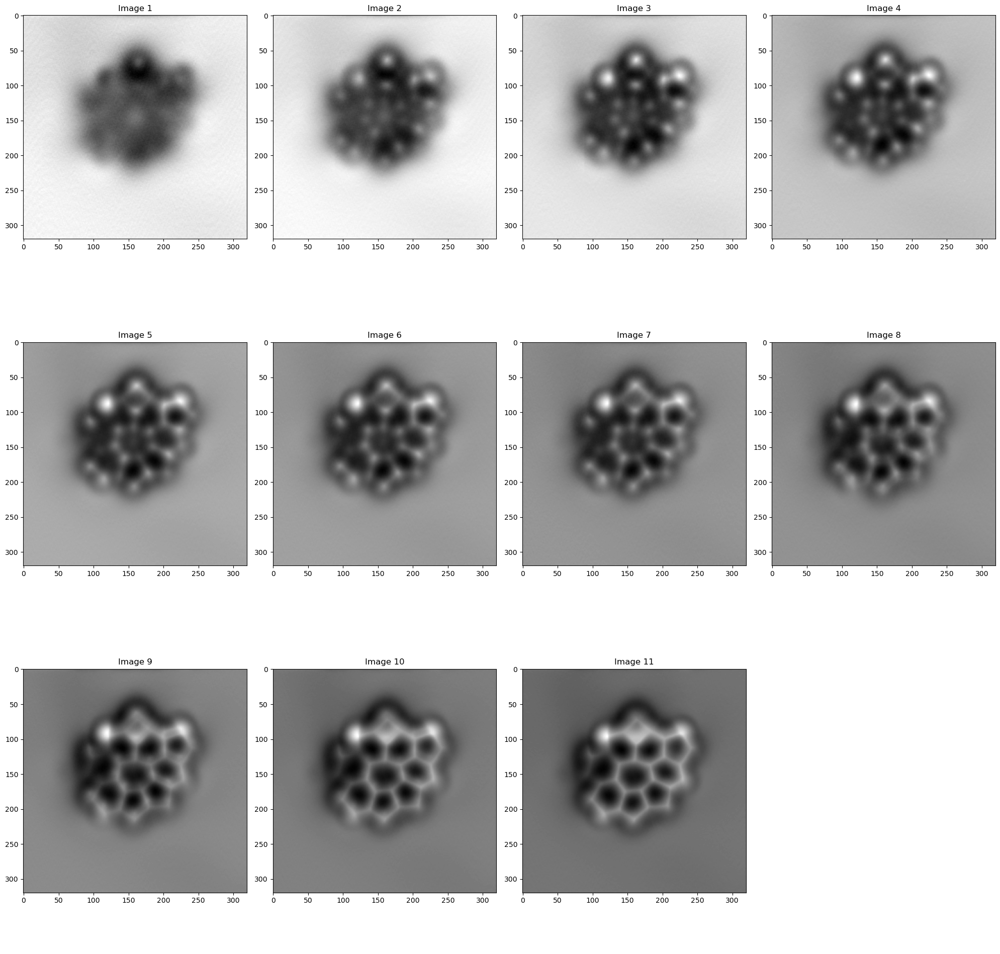

In [21]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Ying_Jiang_5/data.npy'
exp_molecule = np.load(path)
print(exp_molecule.shape)
nrows, ncols = 3, 4

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

(312, 312, 10)


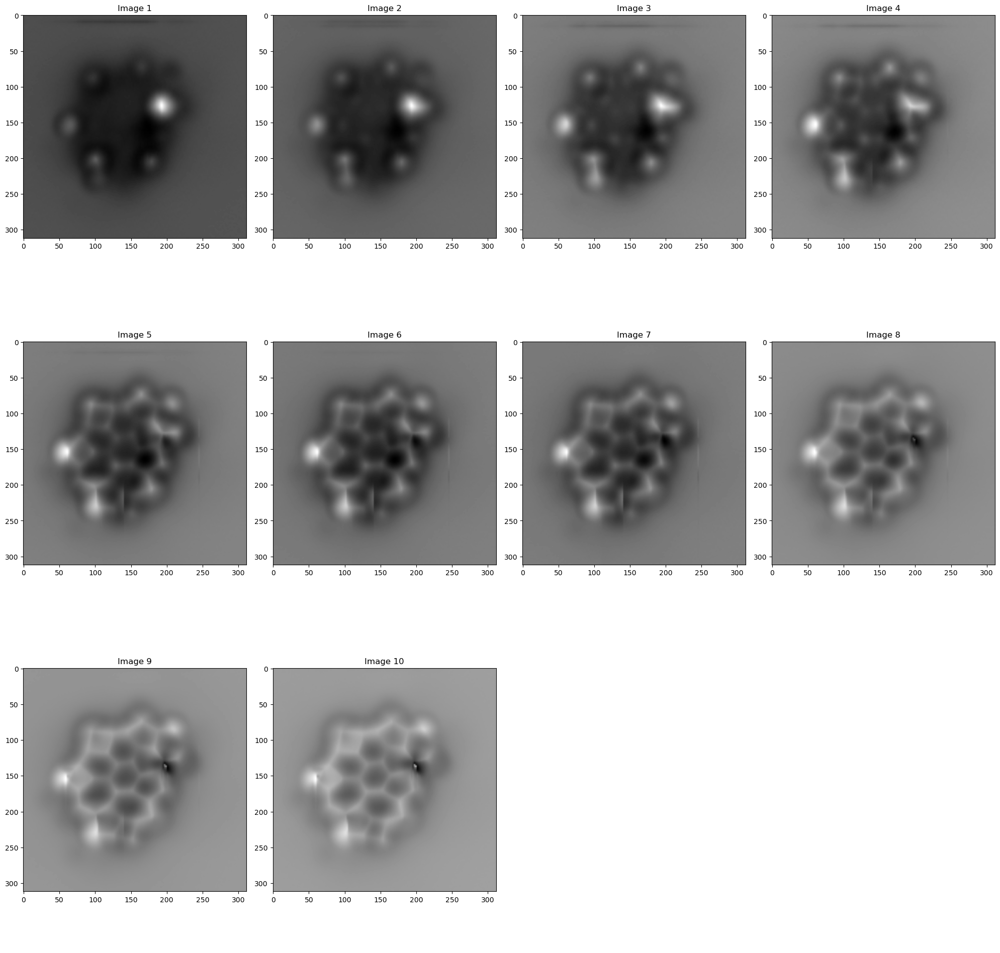

In [22]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Ying_Jiang_6/data.npy'
exp_molecule = np.load(path)
print(exp_molecule.shape)
nrows, ncols = 3, 4

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()

(200, 200, 9)


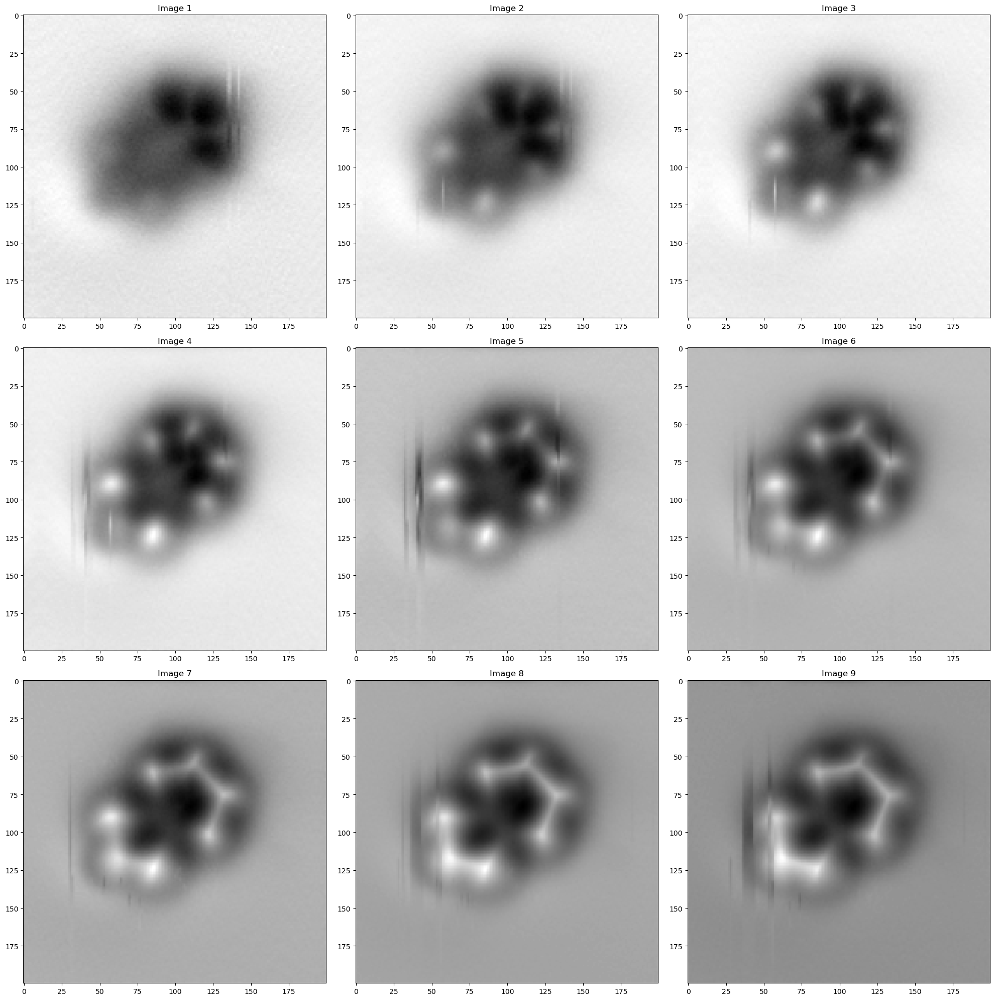

In [23]:
path = f'/home/mgonzalez/EXPERIMENTAL_IMAGES/exp_data_ice/Ying_Jiang_7/data.npy'
exp_molecule = np.load(path)
print(exp_molecule.shape)
nrows, ncols = 3, 3

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 20))

# iterate over all subplots in a 4x4 grid
for i, ax in enumerate(axs.flat):
    # we only have 13 images, so we'll ignore the rest
    if i < exp_molecule.shape[2]:
        # display image in grayscale
        img = ax.imshow(exp_molecule[:, :, i], cmap='gray')
        ax.set_title(f'Image {i+1}')
    # hide the axes for the plots without images
    else:
        ax.axis('off')

# adjust the space between the subplots
plt.tight_layout()
plt.show()